# Get_Market_Index_Data.ipynb

Merging the internal and external data to look for correlation.

In [1]:
# importing the librarIES
import os                           # For file processing.
import csv
import pandas as pd            # For dataframes.
from pathlib import Path
import pyodbc                       # For connecting to SQL Server
import datetime
import numpy
import psutil 
import gc
import hashlib
from datetime import datetime
import os

# importing matplotlib module
import matplotlib.pyplot as plt
plt.style.use('default')
  
# %matplotlib inline: only draw static
# images in the notebook
%matplotlib inline

# For the Yahoo Finance api
from pandas_datareader import data as pdr
import yfinance as yf
yf.pdr_override() # <== that's all it takes :-)



C:\Users\m033\Anaconda3\lib\site-packages\requests\__init__.py:109: RequestsDependencyWarning: urllib3 (1.26.16) or chardet (3.0.0)/charset_normalizer (2.0.4) doesn't match a supported version!
  warnings.warn(


## Set all runtime variables.

In [2]:
pd.set_option('max_row', None)
#pd.options.display.max_rows = 1000

# Set a value for the home folder.
home_folder = "."

# Set values for the various paths.
BASE_DIR = os.path.join( os.path.dirname( home_folder ), '..' )
input_path = BASE_DIR +  "\Synthesisation\data"

# giving directory name
Indices_file = input_path + '\Indices_Data.csv'
full_file = input_path + '\Synthetic_Switch_Data.csv'
training_file = input_path + '\Full_Population_With_Markex_Index_Data.csv'


# Set the date range.
v_start="2020-01-01"
v_end="2024-06-30"

# 1. Add in the Yahoo Finance Index data.

The following market and volatility indices are relevant from the perspective of our market analysts. Use the same timeline as the internal data for correlation - 2022-01 to 2023-03

# 2. Market indices

## Equity:

In [3]:
tickers = ['^GDAXI', '^DJI','^GSPC','^NDX','^FTSE','^STOXX50E','^N225','^HSI']

df_Equity_index = pdr.get_data_yahoo(tickers, start=v_start, end=v_end)

df_Equity_index['Index_Date'] = df_Equity_index.index 
df_Equity_index = df_Equity_index[['Index_Date', 'Close']]
#df_DAX_index = df_DAX_index.rename(columns={"Close": "DAX"})
df_Equity_index = df_Equity_index.reset_index()  

# Drop the multi-level index
df_Equity_index.columns = df_Equity_index.columns.droplevel()

# Rename the columns
df_Equity_index.columns = ['Index_Date','D2','Dax','Dow Jones','S&P 500','NASDAQ 100','FTSE 100','STOXX 50 Europe','NIKKEI 225','Hang Seng']
df_Equity_index = df_Equity_index.drop('D2', axis=1)
#df_Equity_index = df_Equity_index.rename(columns={"Dax": "DaxEq",
#                                                 "Dow Jones": "DowJonesEq",
#                                                 "S&P 500": "S&P500Eq",
#                                                 "NASDAQ 100": "Nasdaq100Eq",
#                                                 "FTSE 100": "Ftse100Eq",
#                                                 "STOXX 50 Europe": "Stoxx50EuropeEq",
#                                                 "NIKKEI 225": "Nikkei225Eq",
#                                                 "Hang Seng": "HangSengEq",})

# Create an AVG column.
#df_Equity_index['Equity_Average'] = df_Equity_index.mean(axis=1)

# Fill NULLs
#df_Equity_index = df_Equity_index.fillna(0)

df_Equity_index.head(5)

[*********************100%***********************]  8 of 8 completed


,Index_Date,Dax,Dow Jones,S&P 500,NASDAQ 100,FTSE 100,STOXX 50 Europe,NIKKEI 225,Hang Seng
0,2020-01-02,28868.800781,7604.299805,13385.929688,3257.850098,28543.519531,NaN,8872.219727,NaN
1,2020-01-03,28634.880859,7622.399902,13219.139648,3234.850098,28451.500000,NaN,8793.900391,3773.370117
2,2020-01-06,28703.380859,7575.299805,13126.990234,3246.280029,28226.189453,23204.859375,8848.519531,3752.520020
3,2020-01-07,28583.679688,7573.899902,13226.830078,3237.179932,28322.060547,23575.720703,8846.450195,3759.250000
4,2020-01-08,28745.089844,7574.899902,13320.179688,3253.050049,28087.919922,23204.759766,8912.370117,3772.560059


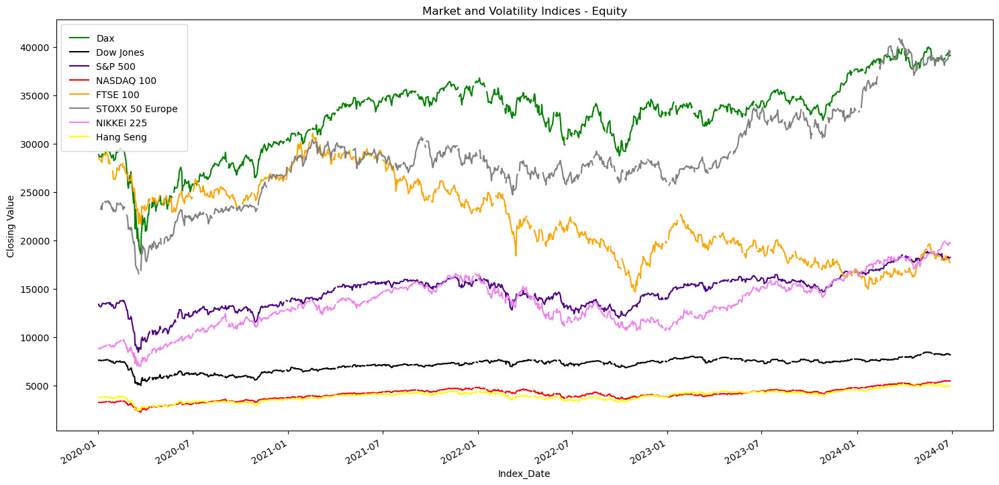

In [47]:
# Get current axis
ax = plt.gca()


#plt.rcParams["figure.figsize"] = 6, 3

# line plot for math marks
df_Equity_index.plot(kind='line',x='Index_Date',y='Dax',color='green', ax=ax)
df_Equity_index.plot(kind='line',x='Index_Date',y='Dow Jones',color='black', ax=ax)
df_Equity_index.plot(kind='line',x='Index_Date',y='S&P 500',color='indigo', ax=ax) 
df_Equity_index.plot(kind='line',x='Index_Date',y='NASDAQ 100',color='red', ax=ax)
df_Equity_index.plot(kind='line',x='Index_Date',y='FTSE 100',color='orange', ax=ax)
df_Equity_index.plot(kind='line',x='Index_Date',y='STOXX 50 Europe',color='grey', ax=ax)
df_Equity_index.plot(kind='line',x='Index_Date',y='NIKKEI 225',color='violet', ax=ax)
df_Equity_index.plot(kind='line',x='Index_Date',y='Hang Seng',color='yellow', ax=ax)
#df_Equity_index.plot(kind='line',x='Index_Date',y='Equity_Average',color='blue', ax=ax)
 
# set the title
plt.title('Market and Volatility Indices - Equity')
plt.ylabel("Closing Value")

# plotting a line plot after changing it's width and height
#plt.rcParams["figure.figsize"] = (10,3)
plt.rcParams["figure.figsize"] = (14,24)

ax.legend(loc='upper left', borderpad=1)
#ax.legend(loc='upper center', borderpad=2)

# show the plot
plt.show()

## Some corresponding Futures:

### -	S&P 500 Futures (Yahoo ticker: ES=F)

In [5]:
df_ESF_index = pdr.get_data_yahoo("ES=F", start=v_start, end=v_end)
df_ESF_index['Index'] = "ES=F"
df_ESF_index['Index_Type'] = "Futures"
df_ESF_index['Index_Description'] = "S&P 500 Futures"

df_ESF_index['Index_Date'] = df_ESF_index.index 
df_ESF_index = df_ESF_index[['Index_Date', 'Close']]
df_ESF_index = df_ESF_index.rename(columns={"Close": "S&P 500 Futures"})

df_ESF_index.head(5)

[*********************100%***********************]  1 of 1 completed


,Index_Date,S&P 500 Futures
Date,,
2020-01-02,2020-01-02,3259.00
2020-01-03,2020-01-03,3235.50
2020-01-06,2020-01-06,3243.50
2020-01-07,2020-01-07,3235.25
2020-01-08,2020-01-08,3260.25


### -	NASDAQ Futures (Yahoo ticker: NQ=F)

In [6]:
df_NQF_index = pdr.get_data_yahoo("NQ=F", start=v_start, end=v_end)
df_NQF_index['Index'] = "NQ=F"
df_NQF_index['Index_Type'] = "Futures"
df_NQF_index['Index_Description'] = "NASDAQ Futures"

df_NQF_index['Index_Date'] = df_NQF_index.index 
df_NQF_index = df_NQF_index[['Index_Date', 'Close']]
df_NQF_index = df_NQF_index.rename(columns={"Close": "NASDAQ Futures"})

df_Futures_index = pd.merge(df_ESF_index, 
                        df_NQF_index,
                        left_on = ['Index_Date'], 
                        right_on = ['Index_Date'] , 
                        how = 'left') 

df_Futures_index.head(5)


[*********************100%***********************]  1 of 1 completed


,Index_Date,S&P 500 Futures,NASDAQ Futures
0,2020-01-02,3259.00,8891.75
1,2020-01-03,3235.50,8810.00
2,2020-01-06,3243.50,8847.50
3,2020-01-07,3235.25,8853.00
4,2020-01-08,3260.25,8944.50


### -	Dow Futures (Yahoo ticker: YM=F)

In [7]:
df_YMF_index = pdr.get_data_yahoo("YM=F", start=v_start, end=v_end)
df_YMF_index['Index'] = "YM=F"
df_YMF_index['Index_Type'] = "Futures"
df_YMF_index['Index_Description'] = "Dow Futures"

df_YMF_index['Index_Date'] = df_YMF_index.index 
df_YMF_index = df_YMF_index[['Index_Date', 'Close']]
df_YMF_index = df_YMF_index.rename(columns={"Close": "Dow Futures"})

df_Futures_index = pd.merge(df_Futures_index, 
                        df_YMF_index,
                        left_on = ['Index_Date'], 
                        right_on = ['Index_Date'] , 
                        how = 'left') 

df_Futures_index.head(5)


[*********************100%***********************]  1 of 1 completed


,Index_Date,S&P 500 Futures,NASDAQ Futures,Dow Futures
0,2020-01-02,3259.00,8891.75,28841.0
1,2020-01-03,3235.50,8810.00,28602.0
2,2020-01-06,3243.50,8847.50,28642.0
3,2020-01-07,3235.25,8853.00,28526.0
4,2020-01-08,3260.25,8944.50,28770.0


## Get the average as this may be a better predictor.

In [8]:
#df_Merge_Futures['Futures_Average'] = df_Merge_Futures.mean(axis=1)
#df_Merge_Futures

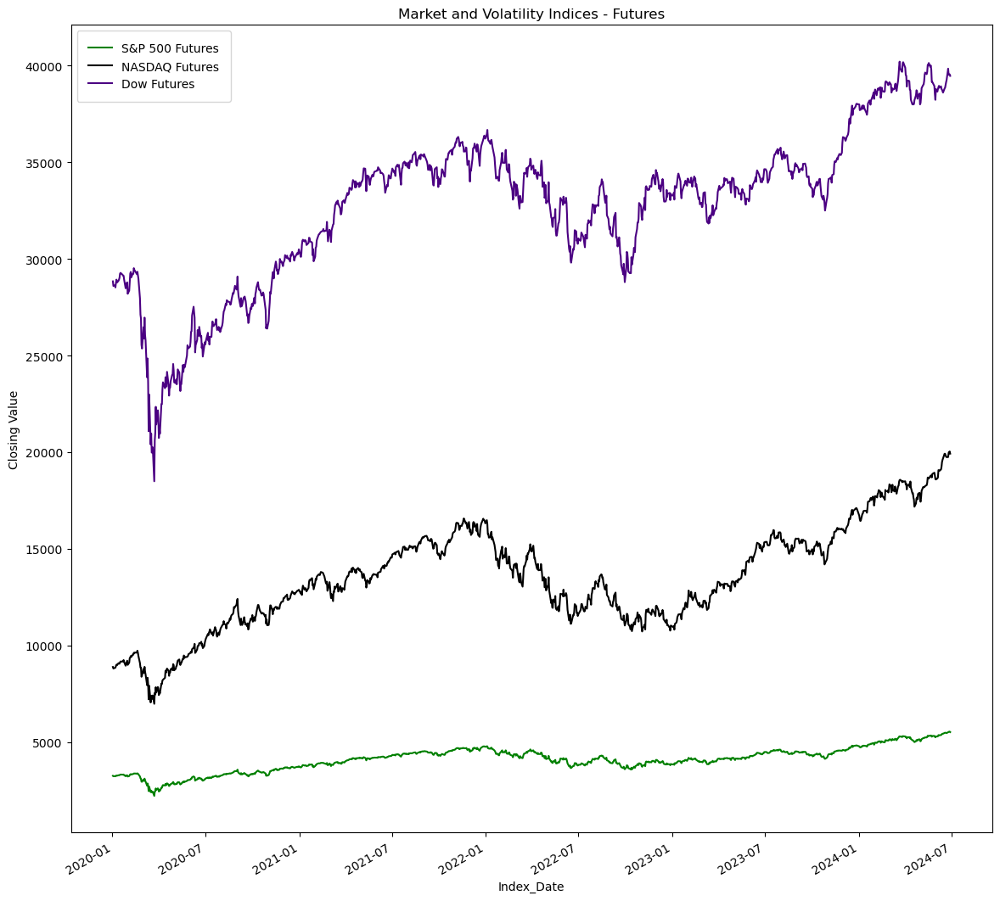

In [9]:
# Get current axis
ax = plt.gca()

# line plot for math marks
df_Futures_index.plot(kind='line',x='Index_Date',y='S&P 500 Futures',color='green', ax=ax)
df_Futures_index.plot(kind='line',x='Index_Date',y='NASDAQ Futures',color='black', ax=ax)
df_Futures_index.plot(kind='line',x='Index_Date',y='Dow Futures',color='indigo', ax=ax) 
#df_Merge_Futures.plot(kind='line',x='Index_Date',y='Futures_Average',color='blue', ax=ax)
 
# set the title
plt.title('Market and Volatility Indices - Futures')
plt.ylabel("Closing Value")

# plotting a line plot after changing it's width and height
plt.rcParams["figure.figsize"] = (18,9)
ax.legend(loc='upper left', borderpad=1)

# show the plot
plt.show()

## ETFs:

ETFs are often popular for investors. ETFs are index funds that track a basket of securities of an index, i.e. these type of products tries to match the market return.  A lot of investors compares these ETFs with other funds in terms of performance and cost (ETFs are normally cheaper than an active fund). From my perspective the most popular indices being used in ETFs are the ones from MSCI, e.g. MSCI World. So I would suggest to include the following ETFs:

### -	iShares Core MSCI World UCITS ETF USD (Acc) (Yahoo ticker: EUNL.DE)

In [10]:
df_EUNLDE_index = pdr.get_data_yahoo("EUNL.DE", start=v_start, end=v_end)
df_EUNLDE_index['Index'] = "EUNL.DE"
df_EUNLDE_index['Index_Type'] = "ETFs"
df_EUNLDE_index['Index_Description'] = "iShares Core MSCI World UCITS ETF USD (Acc)"

df_EUNLDE_index['Index_Date'] = df_EUNLDE_index.index 
df_EUNLDE_index = df_EUNLDE_index[['Index_Date', 'Close']]
df_EUNLDE_index = df_EUNLDE_index.rename(columns={"Close": "CoreMsciETF"})

df_EUNLDE_index.head(5)

[*********************100%***********************]  1 of 1 completed


,Index_Date,CoreMsciETF
Date,,
2020-01-02,2020-01-02,56.700001
2020-01-03,2020-01-03,56.680000
2020-01-06,2020-01-06,56.549999
2020-01-07,2020-01-07,56.902000
2020-01-08,2020-01-08,57.136002


### -	iShares MSCI Emerging Markets ETF (Yahoo ticker: EEM)

In [11]:
df_EEM_index = pdr.get_data_yahoo("EEM", start=v_start, end=v_end)
df_EEM_index['Index'] = "EEM"
df_EEM_index['Index_Type'] = "ETFs"
df_EEM_index['Index_Description'] = "iShares MSCI Emerging Markets ETF"

df_EEM_index['Index_Date'] = df_EEM_index.index 
df_EEM_index = df_EEM_index[['Index_Date', 'Close']]
df_EEM_index = df_EEM_index.rename(columns={"Close": "MsciEmergingETF"})

df_ETFs_Bonds_index = pd.merge(df_EUNLDE_index, 
                        df_EEM_index,
                        left_on = ['Index_Date'], 
                        right_on = ['Index_Date'] , 
                        how = 'left') 

df_ETFs_Bonds_index.head(5)

[*********************100%***********************]  1 of 1 completed


,Index_Date,CoreMsciETF,MsciEmergingETF
0,2020-01-02,56.700001,45.779999
1,2020-01-03,56.680000,44.930000
2,2020-01-06,56.549999,44.820000
3,2020-01-07,56.902000,44.790001
4,2020-01-08,57.136002,45.049999


## Bond:

### -	REX-Index (Yahoo ticker: REX.DE)

In [12]:
df_REXDE_index = pdr.get_data_yahoo("REX.DE", start=v_start, end=v_end)
df_REXDE_index['Index'] = "REX.DE"
df_REXDE_index['Index_Type'] = "Bond"
df_REXDE_index['Index_Description'] = "REX-Index"

df_REXDE_index['Index_Date'] = df_REXDE_index.index 
df_REXDE_index = df_REXDE_index[['Index_Date', 'Close']]
df_REXDE_index = df_REXDE_index.rename(columns={"Close": "RexBond"})

df_ETFs_Bonds_index = pd.merge(df_ETFs_Bonds_index, 
                        df_REXDE_index,
                        left_on = ['Index_Date'], 
                        right_on = ['Index_Date'] , 
                        how = 'left') 

df_ETFs_Bonds_index.head(5)

[*********************100%***********************]  1 of 1 completed

1 Failed download:
- REX.DE: No data found for this date range, symbol may be delisted


,Index_Date,CoreMsciETF,MsciEmergingETF,RexBond
0,2020-01-02,56.700001,45.779999,NaN
1,2020-01-03,56.680000,44.930000,NaN
2,2020-01-06,56.549999,44.820000,NaN
3,2020-01-07,56.902000,44.790001,NaN
4,2020-01-08,57.136002,45.049999,NaN


### -	Bloomberg Barcalys Global Aggregate Bond 

(not directly available in yahoo, use the following ETF instead with the yahoo ticker SPFE.DE)


In [13]:
df_SPFEDE_index = pdr.get_data_yahoo("SPFE.DE", start=v_start, end=v_end)
df_SPFEDE_index['Index'] = "SPFE.DE"
df_SPFEDE_index['Index_Type'] = "Bond"
df_SPFEDE_index['Index_Description'] = "Bloomberg Barcalys Global Aggregate Bond"

df_SPFEDE_index['Index_Date'] = df_SPFEDE_index.index 
df_SPFEDE_index = df_SPFEDE_index[['Index_Date', 'Close']]
df_SPFEDE_index = df_SPFEDE_index.rename(columns={"Close": "BloomBond"})

df_ETFs_Bonds_index = pd.merge(df_ETFs_Bonds_index, 
                        df_SPFEDE_index,
                        left_on = ['Index_Date'], 
                        right_on = ['Index_Date'] , 
                        how = 'left') 

df_ETFs_Bonds_index.head(5)

[*********************100%***********************]  1 of 1 completed


,Index_Date,CoreMsciETF,MsciEmergingETF,RexBond,BloomBond
0,2020-01-02,56.700001,45.779999,NaN,31.038
1,2020-01-03,56.680000,44.930000,NaN,31.122
2,2020-01-06,56.549999,44.820000,NaN,31.112
3,2020-01-07,56.902000,44.790001,NaN,31.101
4,2020-01-08,57.136002,45.049999,NaN,31.084


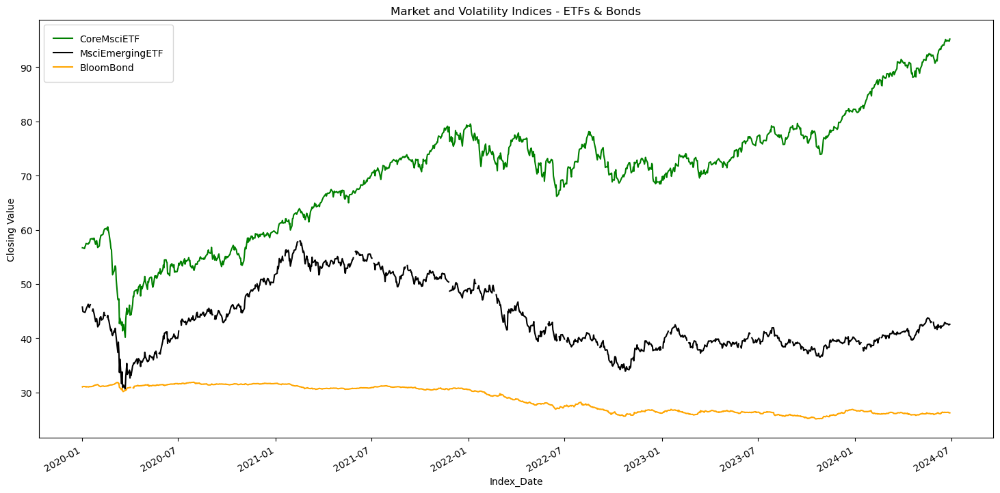

In [14]:
# Get current axis
ax = plt.gca()

# line plot for math marks
df_ETFs_Bonds_index.plot(kind='line',x='Index_Date',y='CoreMsciETF',color='green', ax=ax)
df_ETFs_Bonds_index.plot(kind='line',x='Index_Date',y='MsciEmergingETF',color='black', ax=ax)
df_ETFs_Bonds_index.plot(kind='line',x='Index_Date',y='BloomBond',color='orange', ax=ax)
 
# set the title
plt.title('Market and Volatility Indices - ETFs & Bonds')
plt.ylabel("Closing Value")

# plotting a line plot after changing it's width and height
plt.rcParams["figure.figsize"] = (18,9)
ax.legend(loc='upper left', borderpad=1)

# show the plot
plt.show()

## Commodities:

### -	Gold (Yahoo ticker: GC=F)

In [15]:
df_GCF_index = pdr.get_data_yahoo("GC=F", start=v_start, end=v_end)
df_GCF_index['Index'] = "GC=F"
df_GCF_index['Index_Type'] = "Commodities"
df_GCF_index['Index_Description'] = "Gold"

df_GCF_index['Index_Date'] = df_GCF_index.index 
df_GCF_index = df_GCF_index[['Index_Date', 'Close']]
df_GCF_index = df_GCF_index.rename(columns={"Close": "Gold"})

df_GCF_index.head(5)

[*********************100%***********************]  1 of 1 completed


,Index_Date,Gold
Date,,
2020-01-02,2020-01-02,1524.500000
2020-01-03,2020-01-03,1549.199951
2020-01-06,2020-01-06,1566.199951
2020-01-07,2020-01-07,1571.800049
2020-01-08,2020-01-08,1557.400024


### -	Crude Oil (Yahoo ticker: CL=F)

In [16]:
df_CLF_index = pdr.get_data_yahoo("CL=F", start=v_start, end=v_end)
df_CLF_index['Index'] = "CL=F"
df_CLF_index['Index_Type'] = "Commodities"
df_CLF_index['Index_Description'] = "Crude Oil"

df_CLF_index['Index_Date'] = df_CLF_index.index 
df_CLF_index = df_CLF_index[['Index_Date', 'Close']]
df_CLF_index = df_CLF_index.rename(columns={"Close": "CrudeOil"})

df_Commodities_index = pd.merge(df_GCF_index, 
                        df_CLF_index,
                        left_on = ['Index_Date'], 
                        right_on = ['Index_Date'] , 
                        how = 'left') 

df_Commodities_index.head(5)

[*********************100%***********************]  1 of 1 completed


,Index_Date,Gold,CrudeOil
0,2020-01-02,1524.500000,61.180000
1,2020-01-03,1549.199951,63.049999
2,2020-01-06,1566.199951,63.270000
3,2020-01-07,1571.800049,62.700001
4,2020-01-08,1557.400024,59.610001


### -	Natural Gas (Yahoo ticker: NG=F)

In [17]:
df_NGF_index = pdr.get_data_yahoo("NG=F", start=v_start, end=v_end)
df_NGF_index['Index'] = "NG=F"
df_NGF_index['Index_Type'] = "Commodities"
df_NGF_index['Index_Description'] = "Natural Gas"

df_NGF_index['Index_Date'] = df_NGF_index.index 
df_NGF_index = df_NGF_index[['Index_Date', 'Close']]
df_NGF_index = df_NGF_index.rename(columns={"Close": "NaturalGas"})

df_Commodities_index = pd.merge(df_Commodities_index, 
                        df_NGF_index,
                        left_on = ['Index_Date'], 
                        right_on = ['Index_Date'] , 
                        how = 'left') 

df_Commodities_index.head(5)

[*********************100%***********************]  1 of 1 completed


,Index_Date,Gold,CrudeOil,NaturalGas
0,2020-01-02,1524.500000,61.180000,2.122
1,2020-01-03,1549.199951,63.049999,2.130
2,2020-01-06,1566.199951,63.270000,2.135
3,2020-01-07,1571.800049,62.700001,2.162
4,2020-01-08,1557.400024,59.610001,2.141


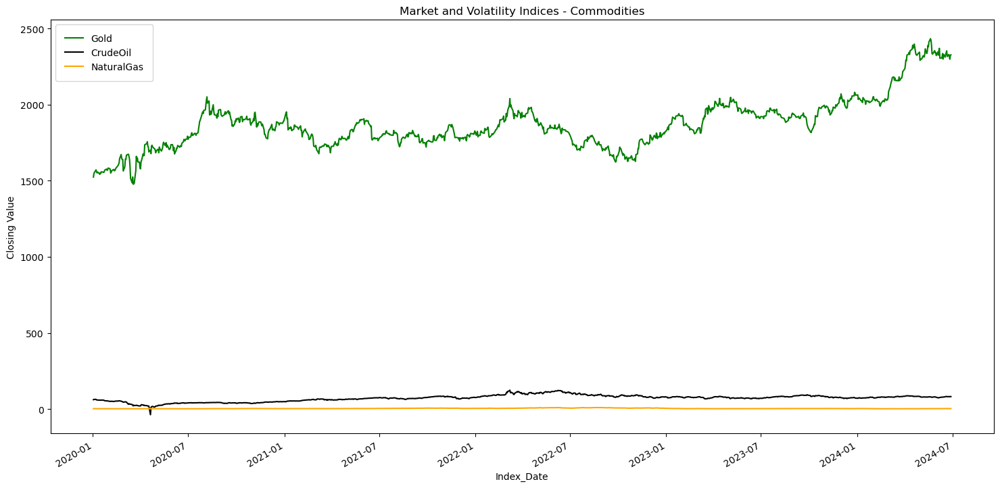

In [18]:
# Get current axis
ax = plt.gca()

# line plot for math marks
df_Commodities_index.plot(kind='line',x='Index_Date',y='Gold',color='green', ax=ax)
df_Commodities_index.plot(kind='line',x='Index_Date',y='CrudeOil',color='black', ax=ax)
df_Commodities_index.plot(kind='line',x='Index_Date',y='NaturalGas',color='orange', ax=ax)
 
# set the title
plt.title('Market and Volatility Indices - Commodities')
plt.ylabel("Closing Value")

# plotting a line plot after changing it's width and height
plt.rcParams["figure.figsize"] = (18,9)
ax.legend(loc='upper left', borderpad=1)

# show the plot
plt.show()

## Currencies:

### -	EUR/USD (Yahoo ticker: EURUSD=X)

In [19]:
df_EURUSDX_index = pdr.get_data_yahoo("EURUSD=X", start=v_start, end=v_end)
df_EURUSDX_index['Index'] = "EURUSD=X"
df_EURUSDX_index['Index_Type'] = "Currencies"
df_EURUSDX_index['Index_Description'] = "EUR/USD"

df_EURUSDX_index['Index_Date'] = df_EURUSDX_index.index 
df_EURUSDX_index = df_EURUSDX_index[['Index_Date', 'Close']]
df_EURUSDX_index = df_EURUSDX_index.rename(columns={"Close": "EurUsd"})

df_EURUSDX_index.head(5)

[*********************100%***********************]  1 of 1 completed


,Index_Date,EurUsd
Date,,
2020-01-01,2020-01-01,1.122083
2020-01-02,2020-01-02,1.122083
2020-01-03,2020-01-03,1.117144
2020-01-06,2020-01-06,1.116196
2020-01-07,2020-01-07,1.119799


### -	EUR/GBP (Yahoo ticker: EURGBP=X)

In [20]:
df_EURGBPX_index = pdr.get_data_yahoo("EURGBP=X", start=v_start, end=v_end)
df_EURGBPX_index['Index'] = "EURGBP=X"
df_EURGBPX_index['Index_Type'] = "Currencies"
df_EURGBPX_index['Index_Description'] = "EUR/GBP"

df_EURGBPX_index['Index_Date'] = df_EURGBPX_index.index 
df_EURGBPX_index = df_EURGBPX_index[['Index_Date', 'Close']]
df_EURGBPX_index = df_EURGBPX_index.rename(columns={"Close": "EurGbp"})

df_Currencies_index = pd.merge(df_EURUSDX_index, 
                      df_EURGBPX_index,
                      left_on = ['Index_Date'], 
                      right_on = ['Index_Date'] , 
                      how = 'left') 

df_Currencies_index.head(5)

[*********************100%***********************]  1 of 1 completed


,Index_Date,EurUsd,EurGbp
0,2020-01-01,1.122083,0.84620
1,2020-01-02,1.122083,0.84657
2,2020-01-03,1.117144,0.84950
3,2020-01-06,1.116196,0.85329
4,2020-01-07,1.119799,0.84998


### -	USD/GBP (Yahoo ticker: GBPUSD=X)

In [21]:
df_GBPUSDX_index = pdr.get_data_yahoo("GBPUSD=X", start=v_start, end=v_end)
df_GBPUSDX_index['Index'] = "GBPUSD=X"
df_GBPUSDX_index['Index_Type'] = "Currencies"
df_GBPUSDX_index['Index_Description'] = "USD/GBP"

df_GBPUSDX_index['Index_Date'] = df_GBPUSDX_index.index 
df_GBPUSDX_index = df_GBPUSDX_index[['Index_Date', 'Close']]
df_GBPUSDX_index = df_GBPUSDX_index.rename(columns={"Close": "UsdGbp"})

df_Currencies_index = pd.merge(df_Currencies_index, 
                      df_GBPUSDX_index,
                      left_on = ['Index_Date'], 
                      right_on = ['Index_Date'] , 
                      how = 'left') 

df_Currencies_index.head(5)

[*********************100%***********************]  1 of 1 completed


,Index_Date,EurUsd,EurGbp,UsdGbp
0,2020-01-01,1.122083,0.84620,1.326260
1,2020-01-02,1.122083,0.84657,1.325030
2,2020-01-03,1.117144,0.84950,1.315270
3,2020-01-06,1.116196,0.85329,1.308010
4,2020-01-07,1.119799,0.84998,1.317003


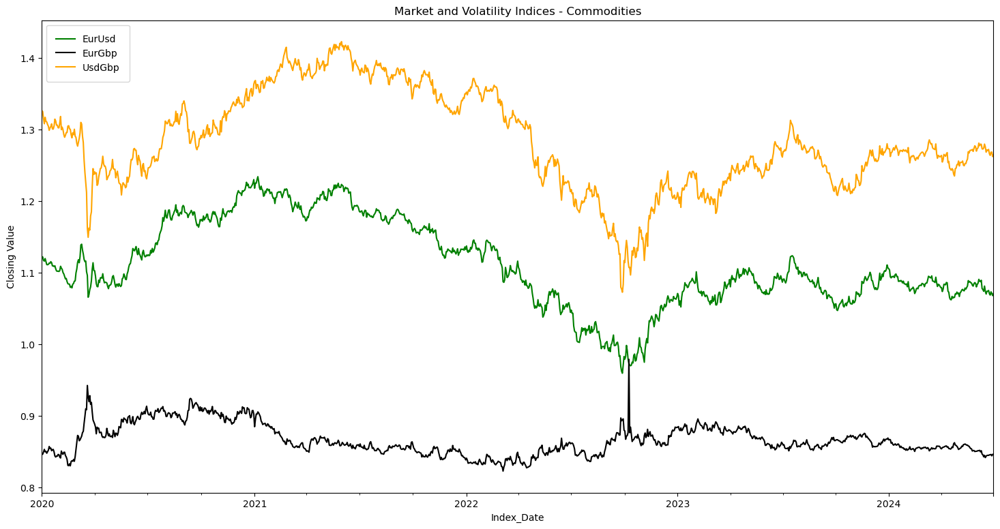

In [22]:
# Get current axis
ax = plt.gca()

# line plot for math marks
df_Currencies_index.plot(kind='line',x='Index_Date',y='EurUsd',color='green', ax=ax)
df_Currencies_index.plot(kind='line',x='Index_Date',y='EurGbp',color='black', ax=ax)
df_Currencies_index.plot(kind='line',x='Index_Date',y='UsdGbp',color='orange', ax=ax)
 
# set the title
plt.title('Market and Volatility Indices - Commodities')
plt.ylabel("Closing Value")

# plotting a line plot after changing it's width and height
plt.rcParams["figure.figsize"] = (18,9)
ax.legend(loc='upper left', borderpad=1)

# show the plot
plt.show()

# 3. Volatility indices

### -	VIX (Yahoo ticker: ^VIX)

In [23]:
df_VIX_index = pdr.get_data_yahoo("^VIX", start=v_start, end=v_end)
df_VIX_index['Index'] = "^VIX"
df_VIX_index['Index_Type'] = "Volatility"
df_VIX_index['Index_Description'] = "VIXX"

df_VIX_index['Index_Date'] = df_VIX_index.index 
df_VIX_index = df_VIX_index[['Index_Date', 'Close']]
df_VIX_index = df_VIX_index.rename(columns={"Close": "VixxVol"})

df_VIX_index.head(5)

[*********************100%***********************]  1 of 1 completed


,Index_Date,VixxVol
Date,,
2020-01-02,2020-01-02,12.47
2020-01-03,2020-01-03,14.02
2020-01-06,2020-01-06,13.85
2020-01-07,2020-01-07,13.79
2020-01-08,2020-01-08,13.45


### -	VSTOXX (Yahoo ticker: V2TX.DE)

In [24]:
df_V2TXDE_index = pdr.get_data_yahoo("V2TX.DE", start=v_start, end=v_end)
df_V2TXDE_index['Index'] = "V2TX.DE"
df_V2TXDE_index['Index_Type'] = "Volatility"
df_V2TXDE_index['Index_Description'] = "VSTOXX"

df_V2TXDE_index['Index_Date'] = df_V2TXDE_index.index 
df_V2TXDE_index = df_V2TXDE_index[['Index_Date', 'Close']]
df_V2TXDE_index = df_V2TXDE_index.rename(columns={"Close": "VstoxxVol"})

df_Volatility_index = pd.merge(df_VIX_index, 
                        df_V2TXDE_index,
                        left_on = ['Index_Date'], 
                        right_on = ['Index_Date'] , 
                        how = 'left') 

df_Volatility_index.head(5)

[*********************100%***********************]  1 of 1 completed

1 Failed download:
- V2TX.DE: No data found for this date range, symbol may be delisted


,Index_Date,VixxVol,VstoxxVol
0,2020-01-02,12.47,NaN
1,2020-01-03,14.02,NaN
2,2020-01-06,13.85,NaN
3,2020-01-07,13.79,NaN
4,2020-01-08,13.45,NaN


### -	VDAX-New (Yahoo ticker: V1X.DE)

In [25]:
df_V1XDE_index = pdr.get_data_yahoo("^VDAX", start=v_start, end=v_end)
df_V1XDE_index['Index'] = "^VDAX"
df_V1XDE_index['Index_Type'] = "Volatility"
df_V1XDE_index['Index_Description'] = "VDAX-New"

df_V1XDE_index['Index_Date'] = df_V1XDE_index.index 
df_V1XDE_index = df_V1XDE_index[['Index_Date', 'Close']]
df_V1XDE_index = df_V1XDE_index.rename(columns={"Close": "VDaxVol"})

df_Volatility_index = pd.merge(df_Volatility_index, 
                        df_V1XDE_index,
                        left_on = ['Index_Date'], 
                        right_on = ['Index_Date'] , 
                        how = 'left') 

df_Volatility_index.head(5)

[*********************100%***********************]  1 of 1 completed

1 Failed download:
- ^VDAX: No data found for this date range, symbol may be delisted


,Index_Date,VixxVol,VstoxxVol,VDaxVol
0,2020-01-02,12.47,NaN,NaN
1,2020-01-03,14.02,NaN,NaN
2,2020-01-06,13.85,NaN,NaN
3,2020-01-07,13.79,NaN,NaN
4,2020-01-08,13.45,NaN,NaN


In [26]:
df_V1XDE_index = pdr.get_data_yahoo("^VDAX", start=v_start, end=v_end)
df_V1XDE_index = pdr.get_data_yahoo("^VDAX", start=v_start, end=v_end)
df_V1XDE_index = pdr.get_data_yahoo("^VDAX", start=v_start, end=v_end)
df_V1XDE_index['Index'] = "^VDAX"
df_V1XDE_index['Index_Type'] = "Volatility"
df_V1XDE_index['Index_Description'] = "VDAX-New"
df_V1XDE_index.head(5)

[*********************100%***********************]  1 of 1 completed

1 Failed download:
- ^VDAX: No data found for this date range, symbol may be delisted
[*********************100%***********************]  1 of 1 completed

1 Failed download:
- ^VDAX: No data found for this date range, symbol may be delisted
[*********************100%***********************]  1 of 1 completed

1 Failed download:
- ^VDAX: No data found for this date range, symbol may be delisted


,Open,High,Low,Close,Adj Close,Volume,Index,Index_Type,Index_Description
Date,,,,,,,,,


# 4. Merge all dataframes

### List all dataframes to concatenate them

In [27]:
%whos DataFrame

Variable               Type         Data/Info
---------------------------------------------
df_CLF_index           DataFrame               Index_Date    <...>28 2024-06-28   81.540001
df_Commodities_index   DataFrame         Index_Date         G<...>1   81.540001       2.601
df_Currencies_index    DataFrame         Index_Date    EurUsd<...>070847  0.84678  1.264574
df_EEM_index           DataFrame               Index_Date  Ms<...>24-06-28        42.590000
df_ESF_index           DataFrame               Index_Date  S&<...>24-06-28      5521.500000
df_ETFs_Bonds_index    DataFrame         Index_Date  CoreMsci<...>90000      NaN  26.250000
df_EUNLDE_index        DataFrame               Index_Date  Co<...>8 2024-06-28    95.185997
df_EURGBPX_index       DataFrame               Index_Date   E<...>06-28 2024-06-28  0.84678
df_EURUSDX_index       DataFrame               Index_Date    <...>6-28 2024-06-28  1.070847
df_Equity_index        DataFrame         Index_Date          <...>682.869141  48

In [50]:
df_All_indices = pd.merge(df_Equity_index,df_Currencies_index,left_on=['Index_Date'],right_on=['Index_Date'],how='left')
df_All_indices = pd.merge(df_All_indices,df_Commodities_index,left_on=['Index_Date'],right_on=['Index_Date'],how='left')
df_All_indices = pd.merge(df_All_indices,df_ETFs_Bonds_index,left_on=['Index_Date'],right_on=['Index_Date'],how='left') 
df_All_indices = pd.merge(df_All_indices,df_Volatility_index,left_on=['Index_Date'],right_on=['Index_Date'],how='left') 
df_All_indices = pd.merge(df_All_indices, df_Futures_index,left_on=['Index_Date'],right_on=['Index_Date'],how='left') 

df_All_indices.head(5)

,Index_Date,Dax,Dow Jones,S&P 500,NASDAQ 100,FTSE 100,STOXX 50 Europe,NIKKEI 225,Hang Seng,EurUsd,...,CoreMsciETF,MsciEmergingETF,RexBond,BloomBond,VixxVol,VstoxxVol,VDaxVol,S&P 500 Futures,NASDAQ Futures,Dow Futures
0,2020-01-02,28868.800781,7604.299805,13385.929688,3257.850098,28543.519531,NaN,8872.219727,NaN,1.122083,...,56.700001,45.779999,NaN,31.038,12.47,NaN,NaN,3259.00,8891.75,28841.0
1,2020-01-03,28634.880859,7622.399902,13219.139648,3234.850098,28451.500000,NaN,8793.900391,3773.370117,1.117144,...,56.680000,44.930000,NaN,31.122,14.02,NaN,NaN,3235.50,8810.00,28602.0
2,2020-01-06,28703.380859,7575.299805,13126.990234,3246.280029,28226.189453,23204.859375,8848.519531,3752.520020,1.116196,...,56.549999,44.820000,NaN,31.112,13.85,NaN,NaN,3243.50,8847.50,28642.0
3,2020-01-07,28583.679688,7573.899902,13226.830078,3237.179932,28322.060547,23575.720703,8846.450195,3759.250000,1.119799,...,56.902000,44.790001,NaN,31.101,13.79,NaN,NaN,3235.25,8853.00,28526.0
4,2020-01-08,28745.089844,7574.899902,13320.179688,3253.050049,28087.919922,23204.759766,8912.370117,3772.560059,1.115474,...,57.136002,45.049999,NaN,31.084,13.45,NaN,NaN,3260.25,8944.50,28770.0


# Write out data.

In [51]:
# Write out to a comma separated values file.
df_All_indices.to_csv(Indices_file, encoding='utf-8', index=False)        
df_All_indices.head(10)

FileNotFoundError: [Errno 2] No such file or directory: '..\\Synthesisation\\data\\Indices_Data.csv'

In [29]:
df_All_indices.dtypes

Index_Date         datetime64[ns]
Gold                      float64
CrudeOil                  float64
NaturalGas                float64
EurUsd                    float64
EurGbp                    float64
UsdGbp                    float64
CoreMsciETF               float64
MsciEmergingETF           float64
RexBond                   float64
BloomBond                 float64
VixxVol                   float64
VstoxxVol                 float64
VDaxVol                   float64
S&P 500 Futures           float64
NASDAQ Futures            float64
Dow Futures               float64
dtype: object

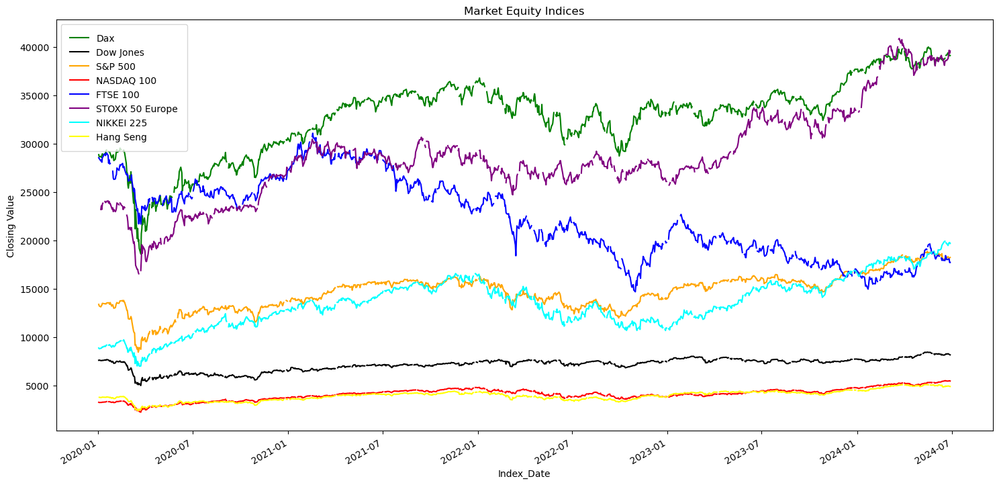

In [55]:
# Get current axis
ax = plt.gca()

# line plot for math marks
df_All_indices.plot(kind='line',x='Index_Date',y='Dax',color='green', ax=ax)
df_All_indices.plot(kind='line',x='Index_Date',y='Dow Jones',color='black', ax=ax)
df_All_indices.plot(kind='line',x='Index_Date',y='S&P 500',color='orange', ax=ax)
df_All_indices.plot(kind='line',x='Index_Date',y='NASDAQ 100',color='red', ax=ax)
df_All_indices.plot(kind='line',x='Index_Date',y='FTSE 100',color='blue', ax=ax)
df_All_indices.plot(kind='line',x='Index_Date',y='STOXX 50 Europe',color='purple', ax=ax)
df_All_indices.plot(kind='line',x='Index_Date',y='NIKKEI 225',color='cyan', ax=ax)
df_All_indices.plot(kind='line',x='Index_Date',y='Hang Seng',color='yellow', ax=ax)
#df_All_indices.plot(kind='line',x='Index_Date',y='RexBond',color='gold', ax=ax)
#df_All_indices.plot(kind='line',x='Index_Date',y='VixxVol',color='grey', ax=ax)
#df_All_indices.plot(kind='line',x='Index_Date',y='VixxVol',color='lime', ax=ax)
#df_All_indices.plot(kind='line',x='Index_Date',y='VstoxxVol',color='steelblue', ax=ax)
#df_All_indices.plot(kind='line',x='Index_Date',y='VDaxVol',color='darkgreen', ax=ax)
#df_All_indices.plot(kind='line',x='Index_Date',y='S&P 500 Futures',color='darkorange', ax=ax)
#df_All_indices.plot(kind='line',x='Index_Date',y='NASDAQ Futures',color='orchid', ax=ax)
#df_All_indices.plot(kind='line',x='Index_Date',y='Dow Futures',color='navy', ax=ax)
 
# set the title
plt.title('Market Equity Indices')
plt.ylabel("Closing Value")

# plotting a line plot after changing it's width and height
plt.rcParams["figure.figsize"] = (18,9)
ax.legend(loc='upper left', borderpad=1)

# show the plot
plt.show()

In [30]:
pd.set_option('max_row', None)
#pd.options.display.max_rows = 1000

# Set a value for the home folder.
home_folder = "."

# Set values for the various paths.
BASE_DIR = os.path.join( os.path.dirname( home_folder ), '..' )
input_path = BASE_DIR +  "\Synthesisation\data"

# giving directory name
full_file = input_path + '\Full_Horizon_All_Features.csv'

print('==========================')
now = datetime.now()
print(now)
print('==========================')
print(psutil.virtual_memory())
print('==========================')
os.path.abspath(os.getcwd())

print(BASE_DIR)
print(input_path)
print(full_file)

2024-07-26 07:56:19.133049
svmem(total=16756752384, available=3179778048, percent=81.0, used=13576974336, free=3179778048)
..
..\Synthesisation\data
..\Synthesisation\data\Full_Horizon_All_Features.csv


In [31]:
df_Switch_Population = pd.read_csv(full_file,low_memory=False, header=0)

# Fill NULLs
df_Switch_Population = df_Switch_Population.fillna(0)

# Track runtime and encironment.
print('==========================')
now = datetime.now()
print(now)
print('==========================')
print(psutil.virtual_memory())
print('==========================')

# print stats.
print(len(df_Switch_Population.index))
print(df_Switch_Population.dtypes)
df_Switch_Population.head(10)

2024-07-26 07:58:58.138900
svmem(total=16756752384, available=5292400640, percent=68.4, used=11464351744, free=5292400640)
6186149
ContractNumber            object
ProdCat                   object
ProdCode                  object
PolicyStatus              object
SnapshotDt                object
Switch_Flag                int64
PolicyFeeType             object
PricingVariant           float64
PayFreq                    int64
IndexationPercent          int64
Premium                  float64
PremiumCalcMethod         object
ServicingBroker          float64
InitialBroker            float64
BrokerCategory            object
InitialRate              float64
RenewalRate              float64
VIPType                  float64
Nationality               object
IsSmoker                  object
PoliticallyExposed       float64
BirthPlace                object
Gender                   float64
MaritalStatus            float64
PensionDisability        float64
WOPDisability            float64
AddressCity

,ContractNumber,ProdCat,ProdCode,PolicyStatus,SnapshotDt,Switch_Flag,PolicyFeeType,PricingVariant,PayFreq,IndexationPercent,...,VN_TARGET_GROUP_CODE,VN_MILIEU_DESCRIPTION,VP_MILIEU_DESCRIPTION,Term,Term_Passed,Term_Remaining,TermRemainingLTEQ_5,TermRemainingLTEQ_10,Age,AnniversaryMth
0,6074160W,XRPP,XRPP_2005V1,I,2020-01-31,0,Ein,0.0,12,0,...,0,0,0,21.0,12.2,8.8,0,1,57.003224,12.0
1,6074937L,XRPP,XRPP_2005V1,I,2020-01-31,0,Ein,0.0,12,0,...,0,0,0,27.0,13.2,13.8,0,0,51.560265,12.0
2,6074962M,XRPP,XRPP_2005V1,I,2020-01-31,0,Ein,0.0,12,0,...,0,0,0,36.0,13.2,22.8,0,0,42.492317,12.0
3,6075850C,XRPP,XRPP_2005V1,F,2020-01-31,0,Ein,0.0,12,0,...,0,0,0,28.0,13.2,14.8,0,0,45.996838,12.0
4,6100638P,XRPP,XRPP_2005V1,I,2020-01-31,0,Ein,0.0,12,0,...,0,0,0,39.0,12.8,26.2,0,0,39.653107,4.0
5,6100746E,XRPP,XRPP_2005V1,I,2020-01-31,0,Ein,0.0,12,0,...,0,0,0,37.0,13.8,23.2,0,0,42.391014,5.0
6,6214246Y,XRPP,XRPP_2005V1,I,2020-01-31,0,Ein,0.0,12,0,...,0,0,0,29.0,14.3,14.7,0,0,50.558191,10.0
7,6215630F,XRPP,XRPP_2005V1,I,2020-01-31,0,Ein,0.0,12,0,...,0,0,0,37.0,14.2,22.8,0,0,42.642902,12.0
8,6215740Y,XRPP,XRPP_2005V1,I,2020-01-31,0,Ein,0.0,12,0,...,0,0,0,29.0,14.3,14.7,0,0,51.141365,10.0
9,6215812A,XRPP,XRPP_2005V1,I,2020-01-31,0,Ein,4015.0,12,0,...,0,0,0,40.0,14.3,25.7,0,0,39.957015,10.0


In [32]:
df_All_indices.head(10)

,Index_Date,Gold,CrudeOil,NaturalGas,EurUsd,EurGbp,UsdGbp,CoreMsciETF,MsciEmergingETF,RexBond,BloomBond,VixxVol,VstoxxVol,VDaxVol,S&P 500 Futures,NASDAQ Futures,Dow Futures
0,2020-01-02,1524.500000,61.180000,2.122,1.122083,0.84657,1.325030,56.700001,45.779999,NaN,31.038000,12.47,NaN,NaN,3259.00,8891.75,28841.0
1,2020-01-03,1549.199951,63.049999,2.130,1.117144,0.84950,1.315270,56.680000,44.930000,NaN,31.122000,14.02,NaN,NaN,3235.50,8810.00,28602.0
2,2020-01-06,1566.199951,63.270000,2.135,1.116196,0.85329,1.308010,56.549999,44.820000,NaN,31.112000,13.85,NaN,NaN,3243.50,8847.50,28642.0
3,2020-01-07,1571.800049,62.700001,2.162,1.119799,0.84998,1.317003,56.902000,44.790001,NaN,31.101000,13.79,NaN,NaN,3235.25,8853.00,28526.0
4,2020-01-08,1557.400024,59.610001,2.141,1.115474,0.85053,1.311372,57.136002,45.049999,NaN,31.084000,13.45,NaN,NaN,3260.25,8944.50,28770.0
5,2020-01-09,1551.699951,59.560001,2.166,1.111321,0.84790,1.310513,57.495998,45.349998,NaN,31.020000,12.54,NaN,NaN,3276.00,9009.00,28929.0
6,2020-01-10,1557.500000,59.040001,2.202,1.111111,0.84995,1.307019,57.438000,45.590000,NaN,31.083000,12.56,NaN,NaN,3264.75,8978.25,28777.0
7,2020-01-13,1548.400024,58.080002,2.182,1.111667,0.85213,1.304563,57.369999,46.299999,NaN,31.035999,12.32,NaN,NaN,3289.75,9088.25,28871.0
8,2020-01-14,1542.400024,58.230000,2.187,1.113573,0.85732,1.298819,57.616001,46.040001,NaN,31.028000,12.39,NaN,NaN,3288.00,9062.50,28934.0
9,2020-01-15,1552.099976,57.810001,2.120,1.113090,0.85452,1.302253,57.594002,45.680000,NaN,31.100000,12.42,NaN,NaN,3293.75,9060.00,29029.0


In [33]:
df_All_indices = df_All_indices.dropna(axis=1, how='all')
print(df_All_indices.dtypes)

df_All_indices.head(10)

Index_Date         datetime64[ns]
Gold                      float64
CrudeOil                  float64
NaturalGas                float64
EurUsd                    float64
EurGbp                    float64
UsdGbp                    float64
CoreMsciETF               float64
MsciEmergingETF           float64
BloomBond                 float64
VixxVol                   float64
S&P 500 Futures           float64
NASDAQ Futures            float64
Dow Futures               float64
dtype: object


,Index_Date,Gold,CrudeOil,NaturalGas,EurUsd,EurGbp,UsdGbp,CoreMsciETF,MsciEmergingETF,BloomBond,VixxVol,S&P 500 Futures,NASDAQ Futures,Dow Futures
0,2020-01-02,1524.500000,61.180000,2.122,1.122083,0.84657,1.325030,56.700001,45.779999,31.038000,12.47,3259.00,8891.75,28841.0
1,2020-01-03,1549.199951,63.049999,2.130,1.117144,0.84950,1.315270,56.680000,44.930000,31.122000,14.02,3235.50,8810.00,28602.0
2,2020-01-06,1566.199951,63.270000,2.135,1.116196,0.85329,1.308010,56.549999,44.820000,31.112000,13.85,3243.50,8847.50,28642.0
3,2020-01-07,1571.800049,62.700001,2.162,1.119799,0.84998,1.317003,56.902000,44.790001,31.101000,13.79,3235.25,8853.00,28526.0
4,2020-01-08,1557.400024,59.610001,2.141,1.115474,0.85053,1.311372,57.136002,45.049999,31.084000,13.45,3260.25,8944.50,28770.0
5,2020-01-09,1551.699951,59.560001,2.166,1.111321,0.84790,1.310513,57.495998,45.349998,31.020000,12.54,3276.00,9009.00,28929.0
6,2020-01-10,1557.500000,59.040001,2.202,1.111111,0.84995,1.307019,57.438000,45.590000,31.083000,12.56,3264.75,8978.25,28777.0
7,2020-01-13,1548.400024,58.080002,2.182,1.111667,0.85213,1.304563,57.369999,46.299999,31.035999,12.32,3289.75,9088.25,28871.0
8,2020-01-14,1542.400024,58.230000,2.187,1.113573,0.85732,1.298819,57.616001,46.040001,31.028000,12.39,3288.00,9062.50,28934.0
9,2020-01-15,1552.099976,57.810001,2.120,1.113090,0.85452,1.302253,57.594002,45.680000,31.100000,12.42,3293.75,9060.00,29029.0


In [34]:
df_Switch_Population['SnapshotDt'] = pd.to_datetime(df_Switch_Population['SnapshotDt'])
df_Switch_Population = df_Switch_Population[['ContractNumber','Switch_Flag','SnapshotDt','Term_Passed','Term_Remaining',
                                             'TermRemainingLTEQ_5','TermRemainingLTEQ_10','Age','AnniversaryMth','ProdCat',
                                             'ProdCode','PolicyStatus','PolicyFeeType','PricingVariant','PayFreq',
                                             'IndexationPercent','Premium','PremiumCalcMethod','ServicingBroker',
                                             'InitialBroker','BrokerCategory','InitialRate','RenewalRate','VIPType',
                                             'Nationality','IsSmoker','PoliticallyExposed','BirthPlace','Gender',
                                             'MaritalStatus','PensionDisability','WOPDisability','AddressCity','PartnerType',
                                             'EUSanctioned','AddressDistrict','Postal_Code','Postal_Code_Name','District',
                                             'State','VN_MILIEU_CODE','VN_TARGET_GROUP_CODE','VN_MILIEU_DESCRIPTION',
                                             'VP_MILIEU_DESCRIPTION','Term']]
print(df_Switch_Population.dtypes)
df_Switch_Population.head(10)

ContractNumber                   object
Switch_Flag                       int64
SnapshotDt               datetime64[ns]
Term_Passed                     float64
Term_Remaining                  float64
TermRemainingLTEQ_5               int64
TermRemainingLTEQ_10              int64
Age                             float64
AnniversaryMth                  float64
ProdCat                          object
ProdCode                         object
PolicyStatus                     object
PolicyFeeType                    object
PricingVariant                  float64
PayFreq                           int64
IndexationPercent                 int64
Premium                         float64
PremiumCalcMethod                object
ServicingBroker                 float64
InitialBroker                   float64
BrokerCategory                   object
InitialRate                     float64
RenewalRate                     float64
VIPType                         float64
Nationality                      object


,ContractNumber,Switch_Flag,SnapshotDt,Term_Passed,Term_Remaining,TermRemainingLTEQ_5,TermRemainingLTEQ_10,Age,AnniversaryMth,ProdCat,...,AddressDistrict,Postal_Code,Postal_Code_Name,District,State,VN_MILIEU_CODE,VN_TARGET_GROUP_CODE,VN_MILIEU_DESCRIPTION,VP_MILIEU_DESCRIPTION,Term
0,6074160W,0,2020-01-31,12.2,8.8,0,1,57.003224,12.0,XRPP,...,0.0,52072.0,Aachen,St�dteregion Aachen,North Rhine-Westphalia,0,0,0,0,21.0
1,6074937L,0,2020-01-31,13.2,13.8,0,0,51.560265,12.0,XRPP,...,0.0,10823.0,Berlin,Berlin,Berlin,0,0,0,0,27.0
2,6074962M,0,2020-01-31,13.2,22.8,0,0,42.492317,12.0,XRPP,...,0.0,61440.0,Oberursel (Taunus),Landkreis Hochtaunuskreis,Hesse,0,0,0,0,36.0
3,6075850C,0,2020-01-31,13.2,14.8,0,0,45.996838,12.0,XRPP,...,0.0,42719.0,Solingen,Solingen,North Rhine-Westphalia,0,0,0,0,28.0
4,6100638P,0,2020-01-31,12.8,26.2,0,0,39.653107,4.0,XRPP,...,0.0,40789.0,Monheim am Rhein,Landkreis Mettmann,North Rhine-Westphalia,0,0,0,0,39.0
5,6100746E,0,2020-01-31,13.8,23.2,0,0,42.391014,5.0,XRPP,...,0.0,53173.0,Bonn,Bonn,North Rhine-Westphalia,0,0,0,0,37.0
6,6214246Y,0,2020-01-31,14.3,14.7,0,0,50.558191,10.0,XRPP,...,0.0,67105.0,Schifferstadt,Landkreis Rhein-Pfalz-Kreis,Rhineland-Palatinate,0,0,0,0,29.0
7,6215630F,0,2020-01-31,14.2,22.8,0,0,42.642902,12.0,XRPP,...,0.0,81476.0,Munich,M�nchen,Bavaria,0,0,0,0,37.0
8,6215740Y,0,2020-01-31,14.3,14.7,0,0,51.141365,10.0,XRPP,...,0.0,76703.0,Kraichtal,Landkreis Karlsruhe,Baden-W�rttemberg,0,0,0,0,29.0
9,6215812A,0,2020-01-31,14.3,25.7,0,0,39.957015,10.0,XRPP,...,0.0,33039.0,Nieheim,Landkreis H�xter,North Rhine-Westphalia,0,0,0,0,40.0


In [35]:
df_Training_Dataset = pd.merge(df_Switch_Population, df_All_indices,left_on=['SnapshotDt'],right_on=['Index_Date'],how='left') 

# Track runtime and encironment.
print('==========================')
now = datetime.now()
print(now)
print('==========================')
print(psutil.virtual_memory())
print('==========================')

# print stats.
print(len(df_Training_Dataset.index))

df_Training_Dataset.head(20)

2024-07-26 07:59:30.129581
svmem(total=16756752384, available=1051525120, percent=93.7, used=15705227264, free=1051525120)
6186149


,ContractNumber,Switch_Flag,SnapshotDt,Term_Passed,Term_Remaining,TermRemainingLTEQ_5,TermRemainingLTEQ_10,Age,AnniversaryMth,ProdCat,...,EurUsd,EurGbp,UsdGbp,CoreMsciETF,MsciEmergingETF,BloomBond,VixxVol,S&P 500 Futures,NASDAQ Futures,Dow Futures
0,6074160W,0,2020-01-31,12.2,8.8,0,1,57.003224,12.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
1,6074937L,0,2020-01-31,13.2,13.8,0,0,51.560265,12.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
2,6074962M,0,2020-01-31,13.2,22.8,0,0,42.492317,12.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
3,6075850C,0,2020-01-31,13.2,14.8,0,0,45.996838,12.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
4,6100638P,0,2020-01-31,12.8,26.2,0,0,39.653107,4.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
5,6100746E,0,2020-01-31,13.8,23.2,0,0,42.391014,5.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
6,6214246Y,0,2020-01-31,14.3,14.7,0,0,50.558191,10.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
7,6215630F,0,2020-01-31,14.2,22.8,0,0,42.642902,12.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
8,6215740Y,0,2020-01-31,14.3,14.7,0,0,51.141365,10.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
9,6215812A,0,2020-01-31,14.3,25.7,0,0,39.957015,10.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0


In [37]:
# Write to a csv file and use index=false to drop teh index from the dataframe
df_Training_Dataset.to_csv(training_file, encoding='utf-8', index=False)

# Track runtime and encironment.
print('==========================')
now = datetime.now()
print(now)
print('==========================')
print(psutil.virtual_memory())
print('==========================')

# print stats.
print(len(df_Training_Dataset.index))

df_Training_Dataset.head(20)

C:\Users\m033\Anaconda3\lib\site-packages\pandas\core\internals\blocks.py:2106: RuntimeWarning: invalid value encountered in cast
  values = values.astype(str)


2024-07-26 09:42:25.458723
svmem(total=16756752384, available=4624093184, percent=72.4, used=12132659200, free=4624093184)
6186149


,ContractNumber,Switch_Flag,SnapshotDt,Term_Passed,Term_Remaining,TermRemainingLTEQ_5,TermRemainingLTEQ_10,Age,AnniversaryMth,ProdCat,...,EurUsd,EurGbp,UsdGbp,CoreMsciETF,MsciEmergingETF,BloomBond,VixxVol,S&P 500 Futures,NASDAQ Futures,Dow Futures
0,6074160W,0,2020-01-31,12.2,8.8,0,1,57.003224,12.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
1,6074937L,0,2020-01-31,13.2,13.8,0,0,51.560265,12.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
2,6074962M,0,2020-01-31,13.2,22.8,0,0,42.492317,12.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
3,6075850C,0,2020-01-31,13.2,14.8,0,0,45.996838,12.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
4,6100638P,0,2020-01-31,12.8,26.2,0,0,39.653107,4.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
5,6100746E,0,2020-01-31,13.8,23.2,0,0,42.391014,5.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
6,6214246Y,0,2020-01-31,14.3,14.7,0,0,50.558191,10.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
7,6215630F,0,2020-01-31,14.2,22.8,0,0,42.642902,12.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
8,6215740Y,0,2020-01-31,14.3,14.7,0,0,51.141365,10.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0
9,6215812A,0,2020-01-31,14.3,25.7,0,0,39.957015,10.0,XRPP,...,1.102913,0.84273,1.3089,56.751999,42.110001,31.472,18.84,3224.0,8997.75,28196.0


In [35]:
#frames = [df_CLF_index,df_DAX_index,df_DJI_index,df_EEM_index,df_ESF_index,df_EUNLDE_index,df_EURGBPX_index,df_EURUSDX_index,
#          df_FTSE_index,df_GBPUSDX_index,df_GCF_index,df_GSPC_index,df_HIS_index,df_N225_index,df_NDX_index,df_NGF_index,
#          df_NQF_index,df_REXDE_index,df_SPFEDE_index,df_STOXX50E_index,df_V1XDE_index,df_V2TXDE_index,df_VIX_index,df_YMF_index]  #
#
# Or perform operations on the DFs
#df_concat_indices = pd.concat(frames)
#df_concat_indices.head(5)

In [37]:
#df_concat_indices['Date'] = df_concat_indices.index
df_concat_indices.head(50)

,Open,High,Low,Close,Adj Close,Volume,Index,Index_Type,Index_Description,Index_Date,...,S&P 500,NASDAQ 100,FTSE 100,STOXX 50 Europe,NIKKEI 225,Hang Seng,Equity_Average,S&P 500 Futures,NASDAQ Futures,Dow Futures
2005-12-30 00:00:00,60.389999,61.250000,59.730000,61.040001,61.040001,72714.0,CL=F,Commodities,Crude Oil,NaT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2006-01-03 00:00:00,61.040001,63.799999,60.810001,63.139999,63.139999,130635.0,CL=F,Commodities,Crude Oil,NaT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2006-01-04 00:00:00,63.000000,63.650002,62.259998,63.419998,63.419998,105194.0,CL=F,Commodities,Crude Oil,NaT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2006-01-05 00:00:00,63.400002,63.799999,62.599998,62.790001,62.790001,104035.0,CL=F,Commodities,Crude Oil,NaT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2006-01-06 00:00:00,62.599998,64.449997,62.599998,64.209999,64.209999,110763.0,CL=F,Commodities,Crude Oil,NaT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2006-01-09 00:00:00,64.150002,64.610001,62.900002,63.500000,63.500000,115558.0,CL=F,Commodities,Crude Oil,NaT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2006-01-10 00:00:00,63.380001,64.199997,63.049999,63.369999,63.369999,111890.0,CL=F,Commodities,Crude Oil,NaT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2006-01-11 00:00:00,63.349998,64.800003,62.599998,63.939999,63.939999,166379.0,CL=F,Commodities,Crude Oil,NaT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2006-01-12 00:00:00,63.980000,65.050003,63.849998,63.939999,63.939999,111400.0,CL=F,Commodities,Crude Oil,NaT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2006-01-13 00:00:00,63.970001,64.330002,63.099998,63.919998,63.919998,111400.0,CL=F,Commodities,Crude Oil,NaT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [34]:
df_concat_indices = df_concat_indices.sort_values(['Date','Index']).reset_index(drop=False)
df_concat_indices.head(50)

KeyError: 'Date'

In [49]:
# Write to a csv file and use index=false to drop teh index from the dataframe
df_concat_indices.to_csv(Market_Indices, encoding='utf-8', index=False)

https://towardsdatascience.com/calculate-and-plot-s-p-500-daily-returns-2ce359e014d6

In [46]:
df_DJI_index

,Open,High,Low,Close,Adj Close,Volume,Index,Index_Type,Index_Description
Date,,,,,,,,,
2005-12-30,10783.860352,10783.860352,10709.419922,10717.500000,10717.500000,191020000,DJI,Equity,Dow Jones Industrial Average
2006-01-03,10718.299805,10862.780273,10684.450195,10847.410156,10847.410156,302950000,DJI,Equity,Dow Jones Industrial Average
2006-01-04,10843.969727,10892.639648,10833.900391,10880.150391,10880.150391,271490000,DJI,Equity,Dow Jones Industrial Average
2006-01-05,10880.389648,10908.250000,10843.650391,10882.150391,10882.150391,250910000,DJI,Equity,Dow Jones Industrial Average
2006-01-06,10875.450195,10968.839844,10875.450195,10959.309570,10959.309570,291740000,DJI,Equity,Dow Jones Industrial Average
...,...,...,...,...,...,...,...,...,...
2024-03-22,39774.058594,39824.761719,39469.531250,39475.898438,39475.898438,332340000,DJI,Equity,Dow Jones Industrial Average
2024-03-25,39410.539062,39430.171875,39296.031250,39313.640625,39313.640625,323670000,DJI,Equity,Dow Jones Industrial Average
2024-03-26,39338.320312,39439.441406,39277.191406,39282.328125,39282.328125,306940000,DJI,Equity,Dow Jones Industrial Average


<AxesSubplot:>

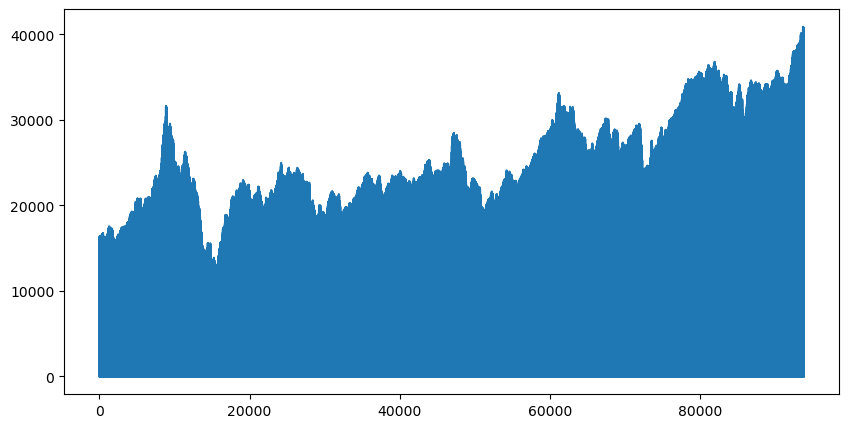

In [47]:
import matplotlib.pyplot as plt
df_concat_indices        ['Close'].plot(figsize=(10, 5))

<AxesSubplot:xlabel='Date'>

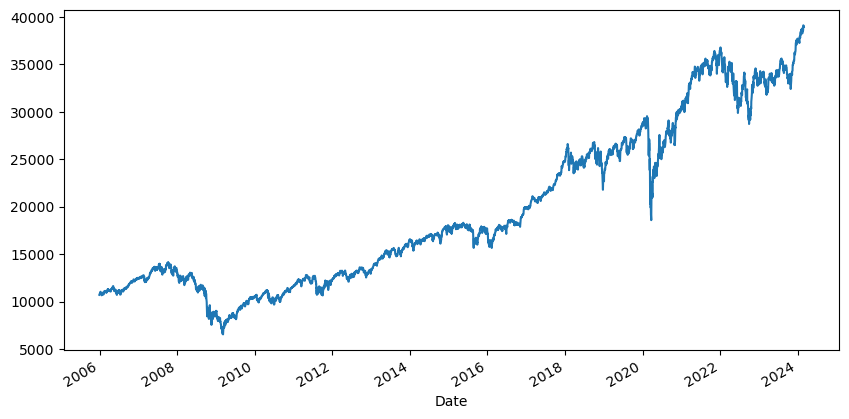

In [39]:
import matplotlib.pyplot as plt
df_DJI_index        ['Close'].plot(figsize=(10, 5))

In [52]:
df_DJI_index['Index_Date'] = df_DJI_index.index 

In [53]:
df_DJI_index

,Open,High,Low,Close,Adj Close,Volume,Index,Index_Type,Index_Description,Index_Date
Date,,,,,,,,,,
2005-12-30,10783.860352,10783.860352,10709.419922,10717.500000,10717.500000,191020000,DJI,Equity,Dow Jones Industrial Average,2005-12-30
2006-01-03,10718.299805,10862.780273,10684.450195,10847.410156,10847.410156,302950000,DJI,Equity,Dow Jones Industrial Average,2006-01-03
2006-01-04,10843.969727,10892.639648,10833.900391,10880.150391,10880.150391,271490000,DJI,Equity,Dow Jones Industrial Average,2006-01-04
2006-01-05,10880.389648,10908.250000,10843.650391,10882.150391,10882.150391,250910000,DJI,Equity,Dow Jones Industrial Average,2006-01-05
2006-01-06,10875.450195,10968.839844,10875.450195,10959.309570,10959.309570,291740000,DJI,Equity,Dow Jones Industrial Average,2006-01-06
...,...,...,...,...,...,...,...,...,...,...
2024-03-22,39774.058594,39824.761719,39469.531250,39475.898438,39475.898438,332340000,DJI,Equity,Dow Jones Industrial Average,2024-03-22
2024-03-25,39410.539062,39430.171875,39296.031250,39313.640625,39313.640625,323670000,DJI,Equity,Dow Jones Industrial Average,2024-03-25
2024-03-26,39338.320312,39439.441406,39277.191406,39282.328125,39282.328125,306940000,DJI,Equity,Dow Jones Industrial Average,2024-03-26


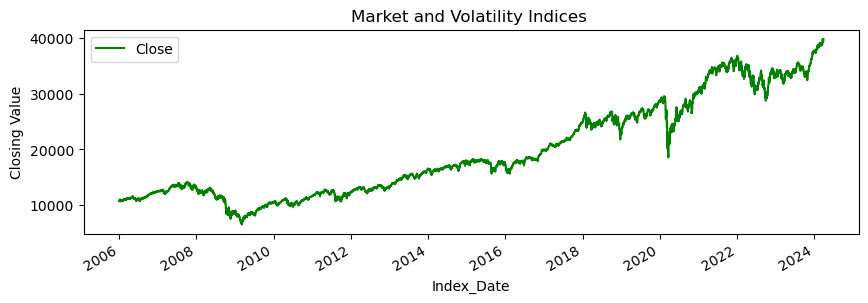

In [59]:
# Get current axis
ax = plt.gca()
 
# line plot for math marks
df_DJI_index.plot(kind='line',
        x='Index_Date',
        y='Close',
        color='green', ax=ax)
 
 
# set the title
plt.title('Market and Volatility Indices ')
plt.ylabel("Closing Value")
#plt.imshow(plotMat, interpolation='nearest', cmap=cmap, aspect="auto")

# plotting a line plot after changing it's width and height
#f = plt.figure()
#f.set_figwidth(8)
#f.set_figheight(1)
#figure(figsize=(12, 6), dpi=80)
plt.rcParams["figure.figsize"] = (10,3)
# show the plot
plt.show()

<AxesSubplot:xlabel='Date'>

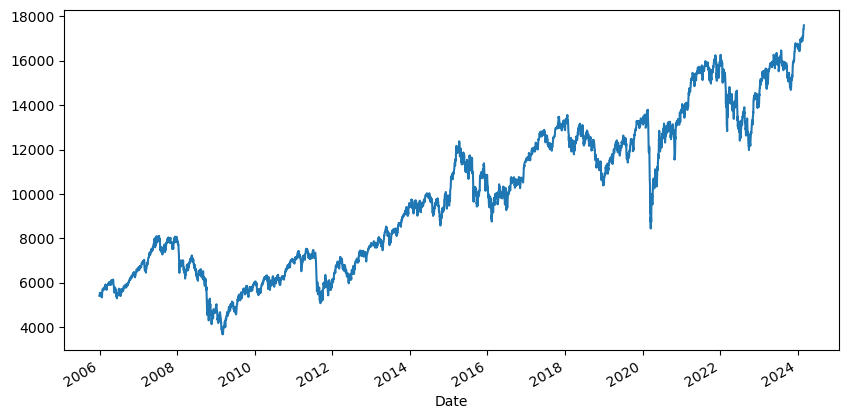

In [40]:
import matplotlib.pyplot as plt
df_DAX_index        ['Close'].plot(figsize=(10, 5))

In [41]:
import plotly.graph_objs as go
import yfinance as yf
choice = input("Write a stock symbol: ")
choice = choice.upper()
fig = go.Figure()
fig.add_trace(go.Candlestick(x=df_concat_indices.index,open = df_concat_indices["Open"], high=df_concat_indices["High"], low=df_concat_indices["Low"], close=df_concat_indices["Close"], name = "market data"))
fig.update_layout(title = choice + " share price", yaxis_title = "Stock Price (USD)")
fig.update_xaxes(
rangeslider_visible=True,
rangeselector=dict(
buttons=list([
])
)
)
fig.show()

Write a stock symbol: 


# 4. Write out index data for future use.

In [42]:
# Write to a csv file and use index=false to drop teh index from the dataframe
df_concat_indices.to_csv(Index_Data, encoding='utf-8', index=False)

In [43]:
df_concat_indices.dtypes

Date                 datetime64[ns]
Open                        float64
High                        float64
Low                         float64
Close                       float64
Adj Close                   float64
Volume                      float64
Index                        object
Index_Type                   object
Index_Description            object
dtype: object

In [ ]:
size the data to similar scale
Feature scaling


In [131]:
df_concat_indices.dtypes

Date                 datetime64[ns]
Open                        float64
High                        float64
Low                         float64
Close                       float64
Adj Close                   float64
Volume                      float64
Index                        object
Index_Type                   object
Index_Description            object
dtype: object

In [76]:
# download dataframe using pandas_datareader
df_DAX_index = pdr.get_data_yahoo("^GDAXI", start="2022-08-30", end="2023-03-30")
df_DAX_index

[*********************100%***********************]  1 of 1 completed


,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2022-08-30,12919.429688,13154.150391,12885.080078,12961.139648,12961.139648,62479300
2022-08-31,13018.480469,13020.540039,12814.809570,12834.959961,12834.959961,82999700
2022-09-01,12713.750000,12743.049805,12603.580078,12630.230469,12630.230469,61602700
2022-09-02,12768.440430,13051.570312,12736.009766,13050.269531,13050.269531,67336800
2022-09-05,12827.580078,12827.580078,12617.400391,12760.780273,12760.780273,62869400
...,...,...,...,...,...,...
2023-03-23,15178.250000,15244.320312,15078.719727,15210.389648,15210.389648,82739800
2023-03-24,15135.500000,15135.650391,14809.820312,14957.230469,14957.230469,181078000
2023-03-27,15133.679688,15185.349609,15020.070312,15127.679688,15127.679688,90911900


In [85]:
# download dataframe using pandas_datareader
df_N225_index = pdr.get_data_yahoo("^SRVIX", start="2018-08-30", end="2023-03-30")
df_N225_index = pdr.get_summary_data("^SRVIX", start="2018-08-30", end="2023-03-30")


#df_N225_index

[*********************100%***********************]  1 of 1 completed

1 Failed download:
- ^SRVIX: No data found for this date range, symbol may be delisted


AttributeError: module 'pandas_datareader.data' has no attribute 'get_summary_data'

# 7 Write out the enhanced data for future use.

In [407]:
# Write to a csv file and use index=false to drop teh index from the dataframe
df_switches.to_csv(Switches_Filename, encoding='utf-8', index=False)

In [408]:
#create new column titled 'Good'
df_switches['Switch1'] = np.where(df_switches['2022-08'], '2022-08', 'NaN')
df_switches['Switch2'] = np.where(df_switches['2022-09'], '2022-09', 'NaN')
df_switches['Switch3'] = np.where(df_switches['2022-10'], '2022-10', 'NaN')
df_switches['Switch4'] = np.where(df_switches['2022-11'], '2022-11', 'NaN')
df_switches['Switch5'] = np.where(df_switches['2022-12'], '2022-12', 'NaN')
df_switches['Switch6'] = np.where(df_switches['2023-01'], '2023-01', 'NaN')
df_switches['Switch7'] = np.where(df_switches['2023-02'], '2023-02', 'NaN')
df_switches['Switch8'] = np.where(df_switches['2023-03'], '2023-03', 'NaN')

#  Convert the columns to date-time
df_switches["Switch1"] = pd.to_datetime(df_switches["Switch1"])
df_switches["Switch2"] = pd.to_datetime(df_switches["Switch2"])
df_switches["Switch3"] = pd.to_datetime(df_switches["Switch3"])
df_switches["Switch4"] = pd.to_datetime(df_switches["Switch4"])
df_switches["Switch5"] = pd.to_datetime(df_switches["Switch5"])
df_switches["Switch6"] = pd.to_datetime(df_switches["Switch6"])
df_switches["Switch7"] = pd.to_datetime(df_switches["Switch7"])
df_switches["Switch8"] = pd.to_datetime(df_switches["Switch8"])

# Drop teh old columns
df_switches = df_switches.drop(columns=['2022-08','2022-09','2022-10','2022-11','2022-12','2023-01','2023-02','2023-03'])
df_switches

,POL_NUMB,202207,Switch1,Switch2,Switch3,Switch4,Switch5,Switch6,Switch7,Switch8
0,001045160#,TSDGBTSDITTSEETTSSITTSYGB,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
1,001045178#,TSDGBTSEAMTSEDETSEETTSESSTSSGBTSYGB,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
2,001046154#,TSESS,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
3,001047062#,TSDGB,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
4,001049026#,TSESD,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
...,...,...,...,...,...,...,...,...,...,...
262012,8154017T,x,NaT,NaT,NaT,NaT,NaT,NaT,2023-02-01,2023-03-01
262013,8154029E,x,NaT,NaT,NaT,NaT,NaT,NaT,2023-02-01,2023-03-01
262014,8154039R,x,NaT,NaT,NaT,NaT,NaT,NaT,2023-02-01,2023-03-01
262015,8154079T,x,NaT,NaT,NaT,NaT,NaT,NaT,2023-02-01,2023-03-01


In [469]:
df_switches.loc[df_switches['2023-03'] == 'NaT', '2023-03'].count()

0

In [474]:
(df_switches['2023-03']=='NaT').sum()

0

In [476]:
df_switches['2023-03'].notnull().sum()

262017

In [477]:
df_switches['2023-02'].notnull().sum()

262017

In [478]:
df_switches.isnull().sum(axis=0)

POL_NUMB    0
202207      0
2022-08     0
2022-09     0
2022-10     0
2022-11     0
2022-12     0
2023-01     0
2023-02     0
2023-03     0
dtype: int64

In [409]:
df_switches.dtypes

POL_NUMB            object
202207              object
Switch1     datetime64[ns]
Switch2     datetime64[ns]
Switch3     datetime64[ns]
Switch4     datetime64[ns]
Switch5     datetime64[ns]
Switch6     datetime64[ns]
Switch7     datetime64[ns]
Switch8     datetime64[ns]
dtype: object

# 8 Write out the enhanced dates based timeline for future use.

In [410]:
# Write to a csv file and use index=false to drop teh index from the dataframe
df_switches.to_csv(Switches_Filename_Dates, encoding='utf-8', index=False)

In [503]:
my_df.dtypes

Date            object
Num_Switches     int64
dtype: object

<AxesSubplot:xlabel='Date'>

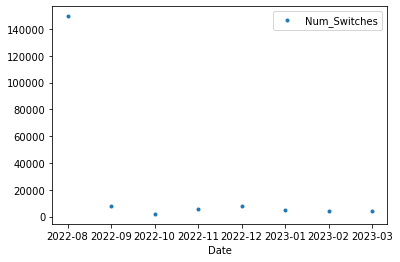

In [504]:
my_df.plot(x='Date', y='Num_Switches', style=".")

In [404]:
# Read the data into a pandas dataframe
df_switches = pd.read_csv(Switches_Filename, delimiter=',',low_memory=False, header=0)
df_switches

,POL_NUMB,202207,2022-08,2022-09,2022-10,2022-11,2022-12,2023-01,2023-02,2023-03
0,001045160#,TSDGBTSDITTSEETTSSITTSYGB,False,False,False,False,False,False,False,False
1,001045178#,TSDGBTSEAMTSEDETSEETTSESSTSSGBTSYGB,False,False,False,False,False,False,False,False
2,001046154#,TSESS,False,False,False,False,False,False,False,False
3,001047062#,TSDGB,False,False,False,False,False,False,False,False
4,001049026#,TSESD,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...
262012,8154017T,x,False,False,False,False,False,False,True,True
262013,8154029E,x,False,False,False,False,False,False,True,True
262014,8154039R,x,False,False,False,False,False,False,True,True
262015,8154079T,x,False,False,False,False,False,False,True,True


In [293]:
df_switches['date'] = pd.to_datetime(dict(year='2022', month='08', day=df_switches.day))
df_switches

ValueError: If using all scalar values, you must pass an index

In [302]:
df = pd.DataFrame({'event':['01-08-2022']})
#df['event'] = pd.to_datetime(df['event'], dayfirst=True)
#df['months'] = df['event'].dt.to_period('M')




df['months'] = pd.to_datetime(df['event'], dayfirst=True).dt.to_period('M')
print (df)

        event   months
0  01-08-2022  2022-08


# 7. Plot the dataframe on a time plot.

In [287]:
# importing matplotlib module
import matplotlib.pyplot as plt
plt.style.use('default')
  
# %matplotlib inline: only draw static
# images in the notebook
%matplotlib inline

In [288]:
# code
# Visualizing The Open Price of all the stocks
  
# to set the plot size
plt.figure(figsize=(16, 8), dpi=150)
  


<Figure size 2400x1200 with 0 Axes>

<Figure size 2400x1200 with 0 Axes>

In [289]:
# using plot method to plot open prices.
# in plot method we set the label and color of the curve.
df_switches['POL_NUMB'].plot(label='POL_NUMB', color='orange')
  
# adding title to the plot
plt.title('Open Price Plot')
  
# adding Label to the x-axis
plt.xlabel('Years')
  
# adding legend to the curve
plt.legend()

TypeError: no numeric data to plot